In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.special as sp
import os as os
import multiprocessing
from joblib import Parallel, delayed
from time import time as ti
from skimage.restoration import denoise_wavelet
import pickle
#import CoreFunctions as cf
import sys
import random
import psutil

In [2]:
DataFolder = '/sciclone/scr10/dchendrickson01/Recordings2/'
DataFolder = '/scratch/Recordings2/'

TIME_STEPS = 1200
Skips = 125
RollSize = 50

tic = ti()
start = tic

MemoryProtection = True

In [3]:
RunTwice = True

In [4]:
FilesPerRun = 12
ConcurrentFiles = 6

In [5]:
def RollingStdDevFaster(RawData, SmoothData, RollSize = 25):

    Diffs = RawData - SmoothData
    del RawData, SmoothData
    
    Sqs = Diffs * Diffs
    del Diffs
    
    Sqs = Sqs.tolist() 
    Sqs.extend(np.zeros(RollSize))
    mSqs = np.matrix(Sqs)
    
    for i in range(RollSize):
        Sqs.insert(0, Sqs.pop())
        mSqs = np.concatenate((np.matrix(Sqs),mSqs))
    
    sVect = mSqs.sum(axis=0)
    eVect = (mSqs!=0).sum(axis=0)
    del mSqs, Sqs
    
    VarVect = sVect / eVect
    StdDevs = np.sqrt(VarVect)
    return np.asarray(StdDevs[:-RollSize].T)

def SquelchPattern(DataSet, StallRange = 5000, SquelchLevel = 0.02, verbose = False):
    
    SquelchSignal = np.ones(len(DataSet))
    if verbose:
        print(len(SquelchSignal))
        
    for i in range(len(DataSet)-2*StallRange):
        if np.average(DataSet[i:i+StallRange]) < SquelchLevel:
            SquelchSignal[i+StallRange]=0

    return SquelchSignal

def split_list_by_zeros(original_list, ones_list):
    # modified split_list_by_ones function to instead split by the zeros.
    #
    #
    # Created with Bing AI support
    #  1st request: "python split list into chunks based on value"
    #  2nd request: "I want to split the list based on the values in a second list.  Second list is all 1s and 0s.  I want all 0s removed, and each set of consequtive ones as its own item"
    #  3rd request: "That is close.  Here is an example of the two lists, and what I would want returned: original_list = [1, 2, 3, 8, 7, 4, 5, 6, 4, 7, 8, 9]
    #                ones_list =     [1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1]
    #                return: [[1, 2, 3, 8], [4, 5, 6], [8,9]]"
    #
    #This is the function that was created and seems to work on the short lists, going to use for long lists
    
    result_sublists = []
    sublist = []

    for val, is_one in zip(original_list, ones_list):
        if not is_one:
            sublist.append(val)
        elif sublist:
            result_sublists.append(sublist)
            sublist = []

    # Add the last sublist (if any)
    if sublist:
        result_sublists.append(sublist)

    return result_sublists

# Generated training sequences for use in the model.
def create_sequences(values, time_steps=TIME_STEPS, skips = Skips):
    output = []
    for i in range(int((len(values) - time_steps + skips)/skips)):
        output.append(values[i*skips : (i*skips + time_steps)])
    return np.stack(output)

In [6]:
def runFile(file, verbose = False, small = False, index=0, start=ti()):
    noise = verbose
    if file[-4:] == '.csv':    
        dataset = pd.read_csv(DataFolder+file, delimiter =",", header=None, engine='python',on_bad_lines='skip')
        if noise:
            print("File Read", ti()-start)
        dataset = dataset.rename(columns={0:"Day"})
        dataset = dataset.rename(columns={1:"Second"})
        dataset = dataset.rename(columns={2:"FracSec"})
        dataset = dataset.rename(columns={3:"p"})
        dataset = dataset.rename(columns={4:"h"})
        dataset = dataset.rename(columns={5:"v"})
        dataset = dataset.rename(columns={6:"Sensor"})

        dataset['Second'].replace('',0)
        dataset['FracSec'].replace('',0)
        dataset.replace([np.nan, np.inf, -np.inf],0,inplace=True)
        
        dataset[['Day','Second']] = dataset[['Day','Second']].apply(lambda x: x.astype(int).astype(str).str.zfill(6))
        dataset[['FracSec']] = dataset[['FracSec']].apply(lambda x: x.astype(int).astype(str).str.zfill(4))

        dataset["timestamp"] = pd.to_datetime(dataset.Day+dataset.Second+dataset.FracSec,format='%y%m%d%H%M%S%f')
        dataset["timestamps"] = dataset["timestamp"]

        dataset["p"] = dataset.p - np.average(dataset.p)
        dataset["h"] = dataset.h - np.average(dataset.h)
        dataset["v"] = dataset.v - np.average(dataset.v)
        dataset["r"] = np.sqrt(dataset.p**2 + dataset.h**2 + dataset.v**2)

        dataset.index = dataset.timestamp

        dataset["SmoothP"] = denoise_wavelet(dataset.p, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')
        dataset["SmoothH"] = denoise_wavelet(dataset.h, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')
        dataset["SmoothV"] = denoise_wavelet(dataset.v, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')
        dataset["SmoothR"] = denoise_wavelet(dataset.r, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')

        if noise:
            print("Data Cleaned", ti()-start, len(dataset.p))

        RawData = dataset.v
        SmoothData = dataset.SmoothV
        RollSize = 25

        Diffs = RawData - SmoothData

        Sqs = Diffs * Diffs

        Sqs = Sqs.tolist() 

        Sqs.extend(np.zeros(RollSize))

        mSqs = np.matrix(Sqs)

        for i in range(RollSize):
            Sqs.insert(0, Sqs.pop())
            mSqs = np.concatenate((np.matrix(Sqs),mSqs))

        sVect = mSqs.sum(axis=0)
        eVect = (mSqs!=0).sum(axis=0)

        VarVect = sVect / eVect

        StdDevs = np.sqrt(VarVect)

        StdDevsZ = np.asarray(StdDevs)

        StdDevsZ=np.append(StdDevsZ,[0])

        StdDevsZ = np.asarray(StdDevsZ.T[:len(dataset.p)])

        if noise:
            print("Size StdDevsZ", ti()-start, np.shape(StdDevsZ))

        #StdDevsZ = np.nan_to_num(StdDevsZ)

        #StdDevsZ[StdDevsZ == np.inf] = 0
        #StdDevsZ[StdDevsZ == -np.inf] = 0

        if noise:
            print("cleaned", ti()-start, np.shape(StdDevsZ))

        SmoothDevZ = denoise_wavelet(StdDevsZ, method='VisuShrink', mode='soft', wavelet='sym2', rescale_sigma='True')

        if noise:
            print("denoise 1", ti()-start, np.shape(StdDevsZ))

        #SmoothDevZa = cf.Smoothing(StdDevsZ, 3, wvt='sym2', dets_to_remove=2, levels=3)
        #SmoothDevZ = np.ravel(SmoothDevZ[0,:])

        #SmoothDevZ = SmoothDevZ.tolist()

        if noise:
            print("denoise 2", ti()-start, np.shape(SmoothDevZ))

        #ataset["SmoothDevZ"] = SmoothDevZ

        SmoothDevZ[np.isnan(SmoothDevZ)]=0
        
        Max = np.max(SmoothDevZ)

        
        
        if noise:
            print("Max", ti()-start, np.shape(Max), Max)

        buckets = int(Max / 0.005) + 1
        bins = np.linspace(0,buckets*0.005,buckets+1)
        counts, bins = np.histogram(SmoothDevZ,bins=bins)

        CummCount = 0
        HalfWay = 0
        for i in range(len(counts)):
            CummCount += counts[i]
            if CummCount / len(SmoothDevZ) >= 0.5:
                if HalfWay == 0:
                    HalfWay = i

        SquelchLevel = bins[HalfWay] 
        if noise:
            print("SmoothDevz size", np.shape(SmoothDevZ))

        dataset["IsMoving"] = SquelchPattern(SmoothDevZ, 4000, SquelchLevel, verbose=noise)

        if noise:
            print("Squelch Made", ti()-start)
        #dataset["velocity"] = getVelocity(dataset.p, dataset.FracSec, dataset.IsMoving, 2)
        #if noise:
        #    print("Velocity Calculated.  File done: ",file)

        #df_pr = split_list_by_ones(dataset.p, dataset.IsMoving)
        #df_hr = split_list_by_ones(dataset.h, dataset.IsMoving)
        #df_vr = split_list_by_ones(dataset.v, dataset.IsMoving)
        #df_rrr = split_list_by_ones(dataset.r, dataset.IsMoving)
        df_ps = split_list_by_zeros(dataset.SmoothP, dataset.IsMoving)
        df_hs = split_list_by_zeros(dataset.SmoothH, dataset.IsMoving)
        df_vs = split_list_by_zeros(dataset.SmoothV, dataset.IsMoving)
        df_rs = split_list_by_zeros(dataset.SmoothR, dataset.IsMoving)

        MatsSmooth = []
        for i in range(len(df_ps)):
            MatsSmooth.append(np.vstack((df_ps[i],df_hs[i],df_vs[i],df_rs[i])))
        
        if verbose:
            print("Split by ones", ti()-start)


        '''df_p=[0]
        df_h=[0]
        df_v=[0]
        df_r=[0]
        df_rp=[0]
        df_rh=[0]
        df_rv=[0]
        df_rr=[0]
        for i in range(len(df_ps)):
            df_p += df_ps[i]
            df_h += df_hs[i]
            df_v += df_vs[i]
            df_r += df_rs[i]
            df_rp += df_pr[i]
            df_rh += df_hr[i]
            df_rv += df_vr[i]
            df_rr += df_rrr[i]
        '''
        if verbose:
            print('format changed', ti()-start, len(MatsSmooth))

        return MatsSmooth
    else:
        return ['fail','fail']
        
        #if verbose:
        #    print('Data normalized', ti()-start)

        #return df_p, df_h, df_v, df_r, df_rp, df_rh, df_rv, df_rr


In [7]:
files= os.listdir(DataFolder) 

In [8]:
random.shuffle(files)

In [9]:
%%time
#df_p, df_h, df_v, df_r, 
Mats = runFile(files[5], verbose = True, small = False, index=0, start=ti())

File Read 83.57159972190857
Data Cleaned 144.25954914093018 18471654
Size StdDevsZ 166.6680850982666 (18471654,)
cleaned 166.66819548606873 (18471654,)
denoise 1 167.12653517723083 (18471654,)
denoise 2 167.12663388252258 (18471654,)
Max 167.13914561271667 () 0.2163854194438462
SmoothDevz size (18471654,)
18471654
Squelch Made 252.57630372047424
Split by ones 261.9606354236603
format changed 261.9607288837433 673
CPU times: user 4min 5s, sys: 16 s, total: 4min 21s
Wall time: 4min 23s


In [10]:
def runWrapper(file, verbose = True, small = False, index=0, start=ti()):
    try:
        rtrn = runFile(file, verbose, small, index, start)
        return rtrn
    except:
        return np.zeros((10,10,3))

In [11]:
%%time
AllDatas = Parallel(n_jobs=ConcurrentFiles)(delayed(runWrapper)(files[(i+8)*7], False, False, 0, ti()) for i in range(FilesPerRun))

CPU times: user 365 ms, sys: 1.36 s, total: 1.73 s
Wall time: 12min 6s


In [12]:
for fileResponse in AllDatas:
    for Mat in fileResponse:
        Mats.append(Mat)

In [13]:
len(Mats)

4635

In [14]:
import CoreFunctions as cf

In [15]:
lengths = []
rejects = []
Keeps = []

In [16]:
for Mat in Mats:
    spm = np.shape(Mat)
    if len(spm) > 1:
        lenM = spm[1]
    else:
        lenM = 1
    if (lenM > 1250):
        lengths.append(lenM)
        Keeps.append(Mat)
    else:
        rejects.append(lenM)

In [17]:
if MemoryProtection:
    print('RAM memory % used:', psutil.virtual_memory()[2])
    del Mats, AllDatas


RAM memory % used: 6.6


In [18]:
len(lengths) / (len(lengths)+len(rejects))

0.3933117583603021

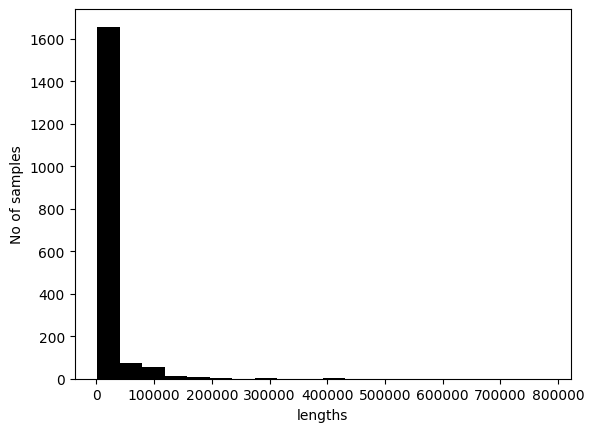

In [19]:
plt.hist(lengths, bins=20)
plt.xlabel("lengths")
plt.ylabel("No of samples")
plt.show()


In [20]:
Prints = []


In [21]:
np.shape(Keeps[3])

(4, 2220)

In [22]:
def PrintWrap(Mat):
    localPrints = []
    lenm = np.shape(Mat)[1]
    slices = int(lenm/TIME_STEPS)
    for i in range(slices):
        temp = (cf.makeMPFast(Mat[:3,i*TIME_STEPS:(i+1)*TIME_STEPS], wvt = 'sym4', scales = 60, spacer = 1, title = ''))
        localPrints.append(temp.astype(np.float32)/255.0)
    return localPrints

In [23]:
%%time
AllPrints = Parallel(n_jobs=8)(delayed(PrintWrap)(Mat) for Mat in Keeps)

CPU times: user 8.37 s, sys: 36.2 s, total: 44.6 s
Wall time: 1min 14s


In [24]:
if MemoryProtection:
    print('RAM memory % used:', psutil.virtual_memory()[2])
    del Keeps

RAM memory % used: 20.5


In [25]:
for group in AllPrints:
    for fprint in group:
        Prints.append(fprint)

for Mat in Keeps:
    lenm = np.shape(Mat)[1]
    slices = int(lenm/TIME_STEPS)
    for i in range(slices):
        temp = (cf.makeMPFast(Mat[:3,i*TIME_STEPS:(i+1)*TIME_STEPS], wvt = 'sym4', scales = 60, spacer = 1, title = ''))
        Prints.append(temp.astype(np.float32)/255.0)

In [26]:
if MemoryProtection:
    print('RAM memory % used:', psutil.virtual_memory()[2])
    del AllPrints


RAM memory % used: 20.4


np.shape(Prints)

In [27]:
len(Prints)

24819

In [28]:
np.max(Prints[1])

1.0

In [29]:
for i in range(7):
    print(np.shape(Prints[i*13]))

(60, 1200, 3)
(60, 1200, 3)
(60, 1200, 3)
(60, 1200, 3)
(60, 1200, 3)
(60, 1200, 3)
(60, 1200, 3)


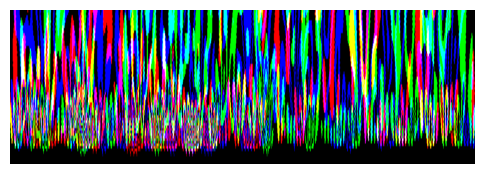

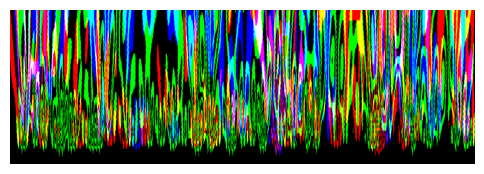

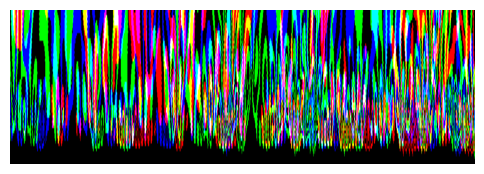

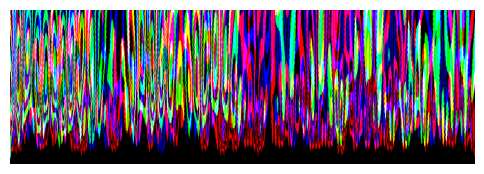

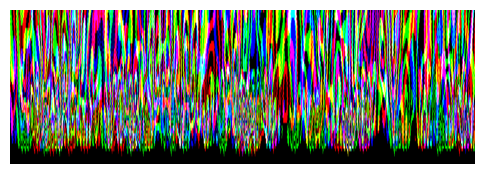

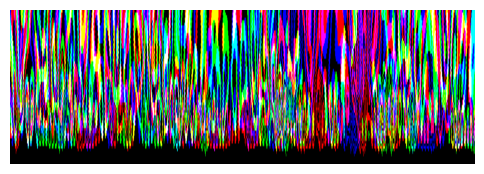

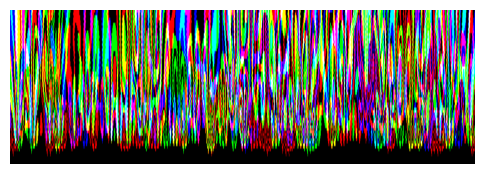

In [30]:
for i in range(7):
    fig = plt.figure(figsize=(6,2), dpi=100)
    plt.axis("off")
    plt.imshow(Prints[i*13], origin='lower',aspect='auto')
    plt.show()

# Start Machine Learning
## Using Autoencoder with Kears and Tensorflow
cite: https://pyimagesearch.com/2020/02/17/autoencoders-with-keras-tensorflow-and-deep-learning/

In [31]:
# import the necessary packages
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Reshape
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
import numpy as np

2024-09-28 13:43:49.446190: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-28 13:43:49.469550: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-28 13:43:49.475357: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-28 13:43:49.501702: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [32]:
class ConvAutoencoder:
    @staticmethod
    def build(width, height, depth, filters=(32, 64), latentDim=16):
        inputShape = (height, width, depth)
        chanDim = -1
        inputs = Input(shape=inputShape)
        x = inputs

        for f in filters:
            x = Conv2D(f, (3, 3), strides=2, padding="same")(x)
            x = LeakyReLU(alpha=0.2)(x)
            x = BatchNormalization(axis=chanDim)(x)

        volumeSize = K.int_shape(x)
        print("Volume Size:", volumeSize)
        x = Flatten()(x)
        latent = Dense(latentDim)(x)

        encoder = Model(inputs, latent, name="encoder")

        latentInputs = Input(shape=(latentDim,))
        flattenedVolumeSize = int(np.prod(volumeSize[1:]))
        print("Flattened Volume Size:", flattenedVolumeSize)
        x = Dense(flattenedVolumeSize)(latentInputs)
        x = Reshape((volumeSize[1], volumeSize[2], volumeSize[3]))(x)

        for f in filters[::-1]:
            x = Conv2DTranspose(f, (3, 3), strides=2, padding="same")(x)
            x = LeakyReLU(alpha=0.2)(x)
            x = BatchNormalization(axis=chanDim)(x)

        x = Conv2DTranspose(depth, (3, 3), padding="same")(x)
        outputs = Activation("sigmoid")(x)

        decoder = Model(latentInputs, outputs, name="decoder")
        autoencoder = Model(inputs, decoder(encoder(inputs)), name="autoencoder")

        return (encoder, decoder, autoencoder)


In [33]:
# set the matplotlib backend so figures can be saved in the background
import matplotlib
matplotlib.use("Agg")
# import the necessary packages
#from pyimagesearch.convautoencoder import ConvAutoencoder
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.datasets import mnist
import matplotlib.pyplot as plt
import numpy as np
import argparse
import cv2
# construct the argument parse and parse the arguments


In [34]:
import random
import tensorflow as tf

In [35]:
from tensorflow.keras.callbacks import Callback

In [36]:
import keras

In [37]:
# initialize the number of epochs to train for and batch size
EPOCHS = 25
BS = 32
TestSplit = 10 # 1/this many

# load the MNIST dataset

random.shuffle(Prints)

TestLength = int(len(Prints)/TestSplit)

In [38]:
np.shape(Prints)

(24819, 60, 1200, 3)

In [39]:
print(type(Prints))
print(Prints[0].dtype)
print(np.shape(Prints))
print('RAM memory % used:', psutil.virtual_memory()[2])

<class 'list'>
float32
(24819, 60, 1200, 3)
RAM memory % used: 20.6



# Assuming 'Prints' is your list

# Convert the list to a NumPy array with a consistent data type
try:
    prints_array = np.array(Prints, dtype=np.float32)
except Exception as e:
    print(f"Error converting to NumPy array: {e}")

# Check the shape and type of the NumPy array
print(f"Shape of prints_array: {prints_array.shape}")
print(f"Data type of prints_array: {prints_array.dtype}")

# Convert the NumPy array to a TensorFlow tensor
try:
    tensor_prints = tf.convert_to_tensor(prints_array)
    print(tensor_prints)
except Exception as e:
    print(f"Error converting to TensorFlow tensor: {e}")


In [40]:
for i, image in enumerate(Prints):
    if not isinstance(image, np.ndarray):
        Prints[i] = np.array(image, dtype=np.float32)
    elif image.dtype != np.float32:
        Prints[i] = image.astype(np.float32)

# Stack the images into a single NumPy array
prints_array = np.stack(Prints, axis=0)

if MemoryProtection:
    del Prints
    print('RAM memory % used:', psutil.virtual_memory()[2])

RAM memory % used: 36.5


In [41]:
if psutil.virtual_memory()[2] > 49:
    temp = (float(psutil.virtual_memory()[2]) - 50.0) / 50.0
    temp2 = int(np.shape(prints_array)[0]*temp)
    prints_array = prints_array[:temp2]

In [42]:
np.shape(prints_array)

(24819, 60, 1200, 3)

In [43]:
# Convert the NumPy array to a TensorFlow tensor
tensor_prints = tf.convert_to_tensor(prints_array)

2024-09-28 13:44:16.787154: I tensorflow/core/common_runtime/gpu/gpu_device.cc:2021] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43598 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:21:00.0, compute capability: 8.6
2024-09-28 13:44:16.790435: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 21443616000 exceeds 10% of free system memory.


In [44]:
ImageShape = np.shape(tensor_prints)

In [45]:
if MemoryProtection:
    del prints_array
    print('RAM memory % used:', psutil.virtual_memory()[2])

RAM memory % used: 37.5


NP = []
for prt in Prints:
    temp = tf.convert_to_tensor(prt)
    NP.append(temp)
NP = tf.onvert_to_tensor(NP)

trainX = np.asarray(Prints[:TestLength]).astype('float32')

testX = Prints[TestLength:]

In [46]:
trX = tensor_prints[:TestLength]  #tf.convert_to_tensor(trainX, dtype=tf.float32)

In [47]:
teX = tensor_prints[TestLength:]  #tf.convert_to_tensor(testX, dtype=tf.float32)

In [48]:
if MemoryProtection:
    del tensor_prints

In [49]:
# construct our convolutional autoencoder
print("[INFO] building autoencoder...")

[INFO] building autoencoder...


In [50]:
(encoder, decoder, autoencoder) = ConvAutoencoder.build(ImageShape[2], ImageShape[1], ImageShape[3])

Volume Size: (None, 15, 300, 64)
Flattened Volume Size: 288000


/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [51]:
print(encoder.summary())
print(decoder.summary())
print(autoencoder.summary())

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 60, 1200, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 30, 600, 32)    │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 30, 600, 32)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 30, 600, 32)    │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 15, 300, 64)    │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 15, 300, 64)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 15, 300, 64)    │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 288000)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 16)             │     4,608,016 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,627,792 (17.65 MB)

 Trainable params: 4,627,600 (17.65 MB)

 Non-trainable params: 192 (768.00 B)

None


Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 288000)         │     4,896,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 15, 300, 64)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 30, 600, 64)    │        36,928 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 30, 600, 64)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 30, 600, 64)    │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 60, 1200, 32)   │        18,464 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 60, 1200, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 60, 1200, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 60, 1200, 3)    │           867 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 60, 1200, 3)    │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,952,643 (18.89 MB)

 Trainable params: 4,952,451 (18.89 MB)

 Non-trainable params: 192 (768.00 B)

None


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 60, 1200, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 16)             │     4,627,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 60, 1200, 3)    │     4,952,643 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,580,435 (36.55 MB)

 Trainable params: 9,580,051 (36.54 MB)

 Non-trainable params: 384 (1.50 KB)

None


In [52]:
opt = Adam(learning_rate=2e-2)
autoencoder.compile(loss="mse", optimizer=opt)
# train the convolutional autoencoder

In [53]:

class CustomModelCheckpoint(Callback):
    def __init__(self, filepath, save_freq):
        super(CustomModelCheckpoint, self).__init__()
        self.filepath = filepath
        self.save_freq = save_freq

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.save_freq == 0:
            self.model.save(self.filepath.format(epoch=epoch + 1))

In [54]:
checkpoint_callback = CustomModelCheckpoint(
    filepath='/scratch/models/3DFP_0927{epoch:02d}.keras',
    save_freq=3  
)

tb_callback = tf.keras.callbacks.TensorBoard(log_dir='/scratch/models/profiles/0927',
                                            profile_batch='01, 125')

es_callback = keras.callbacks.EarlyStopping(monitor="loss", patience=5, mode="min")

2024-09-28 13:45:03.272694: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:103] Profiler session initializing.
2024-09-28 13:45:03.272728: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:118] Profiler session started.
2024-09-28 13:45:03.276073: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:892] Profiler found 1 GPUs
2024-09-28 13:45:03.464935: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:130] Profiler session tear down.
2024-09-28 13:45:03.465027: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:1036] CUPTI activity buffer flushed


In [55]:
H = autoencoder.fit(
	trX, trX,
	validation_data=(teX, teX),
	epochs=25,
    callbacks=[checkpoint_callback, es_callback, tb_callback],     
	batch_size=BS*2)

Epoch 1/25


2024-09-28 13:45:05.132018: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:103] Profiler session initializing.
2024-09-28 13:45:05.132062: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:118] Profiler session started.
I0000 00:00:1727545508.632441  627302 service.cc:146] XLA service 0x14a7d423c310 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1727545508.632504  627302 service.cc:154]   StreamExecutor device (0): NVIDIA A40, Compute Capability 8.6
2024-09-28 13:45:08.875874: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-09-28 13:45:09.316528: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8906
I0000 00:00:1727545520.110468  627302 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step - loss: 0.2437

2024-09-28 13:45:31.425192: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 19300032000 exceeds 10% of free system memory.


39/39 ━━━━━━━━━━━━━━━━━━━━ 40s 648ms/step - loss: 0.2432 - val_loss: 0.3227
Epoch 2/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 12s 325ms/step - loss: 0.2073 - val_loss: 0.2284
Epoch 3/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 334ms/step - loss: 0.2068 - val_loss: 0.2099
Epoch 4/25
 7/39 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - loss: 0.2066

2024-09-28 13:46:10.864645: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:68] Profiler session collecting data.
2024-09-28 13:46:10.882018: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:1036] CUPTI activity buffer flushed
2024-09-28 13:46:11.100324: I external/local_xla/xla/backends/profiler/gpu/cupti_collector.cc:534]  GpuTracer has collected 115880 callback api events and 104538 activity events. 
2024-09-28 13:46:11.711391: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:130] Profiler session tear down.
2024-09-28 13:46:11.772332: I external/local_tsl/tsl/profiler/rpc/client/save_profile.cc:147] Collecting XSpace to repository: /scratch/models/profiles/0927/plugins/profile/2024_09_28_13_46_11/gu03.sciclone.wm.edu.xplane.pb


39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 351ms/step - loss: 0.2065 - val_loss: 0.2065
Epoch 5/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 330ms/step - loss: 0.2067 - val_loss: 0.2273
Epoch 6/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 327ms/step - loss: 0.2059 - val_loss: 0.2199
Epoch 7/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 12s 317ms/step - loss: 0.2059 - val_loss: 0.2067
Epoch 8/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 334ms/step - loss: 0.2056 - val_loss: 0.2125
Epoch 9/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 330ms/step - loss: 0.2052 - val_loss: 0.2146
Epoch 10/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 330ms/step - loss: 0.2046 - val_loss: 0.2126
Epoch 11/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 12s 322ms/step - loss: 0.2040 - val_loss: 0.2107
Epoch 12/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 335ms/step - loss: 0.2042 - val_loss: 0.2075
Epoch 13/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 12s 324ms/step - loss: 0.2037 - val_loss: 0.2068
Epoch 14/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 12s 319ms/step - loss: 0.2040 - val_loss: 0.2050
Epoch 15/25
39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 335ms/

In [56]:
plt.plot(H.history["loss"], label="Training Loss")
plt.plot(H.history["val_loss"], label="Validation Loss")
plt.legend()
plt.show()

In [57]:
x_train_pred = autoencoder.predict(teX[:1000])

32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 44ms/step


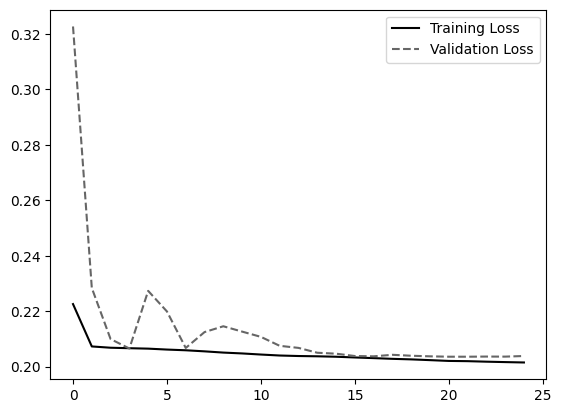

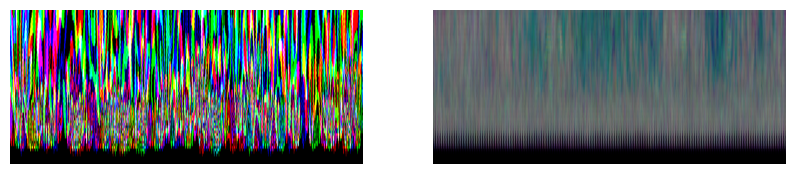

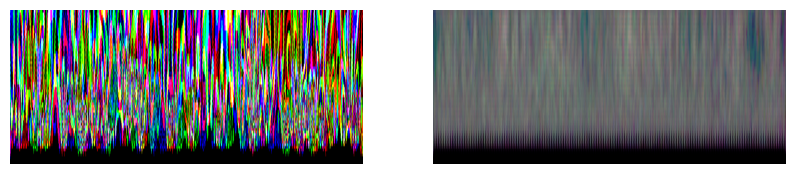

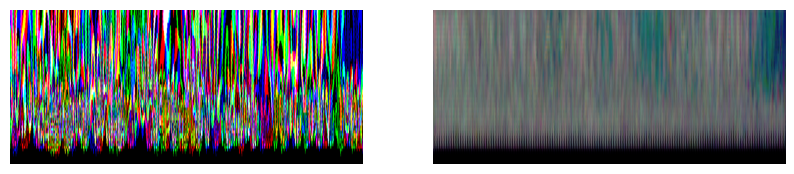

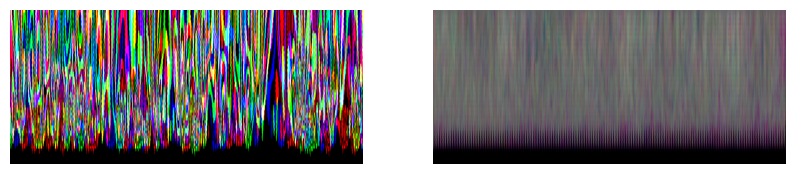

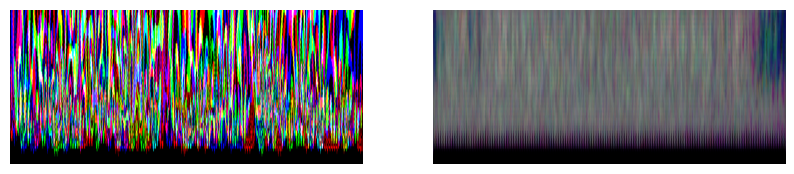

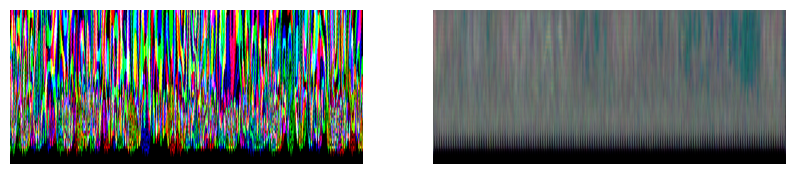

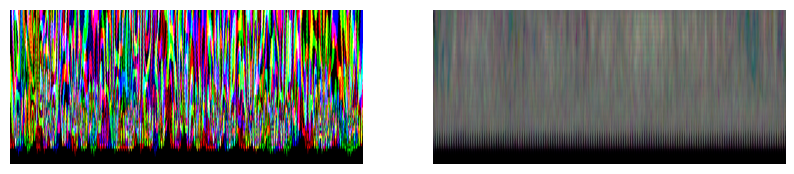

In [58]:
%matplotlib inline
for i in range(7):
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(10,2), dpi=100 )
    ax1.imshow(teX[i*13], origin='lower',aspect='auto')
    ax1.axis("off")
    ax2.imshow(x_train_pred[i*13], origin='lower',aspect='auto')
    plt.axis("off")
    plt.show()

In [59]:
del trX, teX

In [60]:
del x_train_pred

In [61]:
toc = ti()

Epoch 1/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 26s 82ms/step - loss: 0.1955 - val_loss: 0.1964
Epoch 2/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 74ms/step - loss: 0.1953 - val_loss: 0.1967
Epoch 3/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 75ms/step - loss: 0.1950 - val_loss: 0.1967
Epoch 4/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 73ms/step - loss: 0.1952 - val_loss: 0.1971
Epoch 5/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 74ms/step - loss: 0.1950 - val_loss: 0.1970


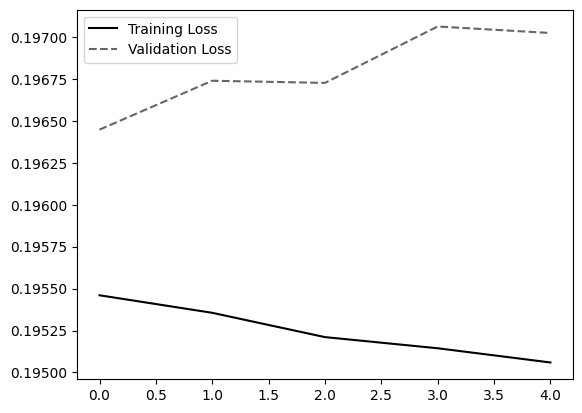

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 942ms/step


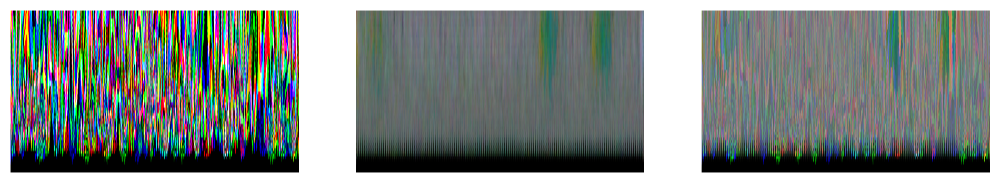

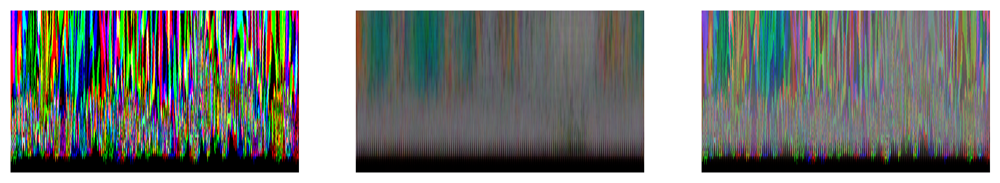

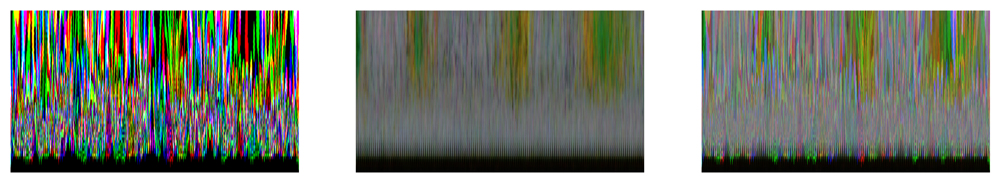

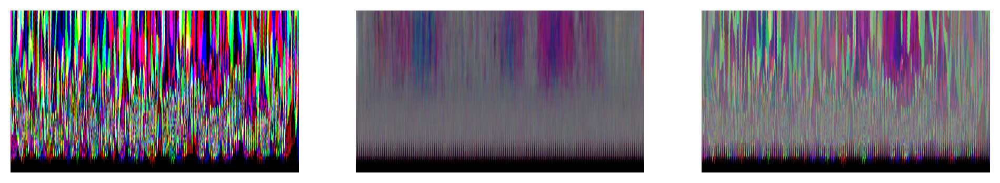

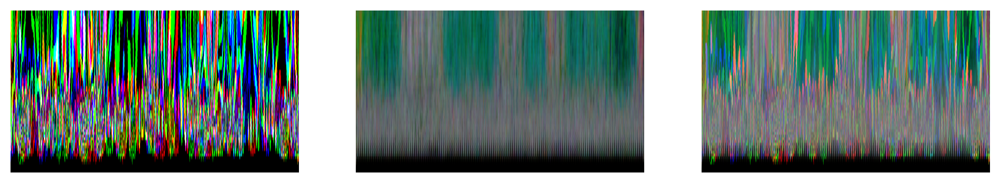

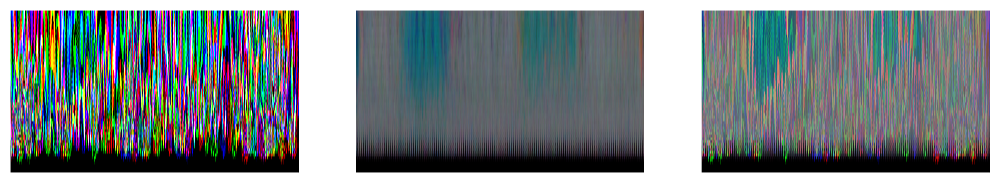

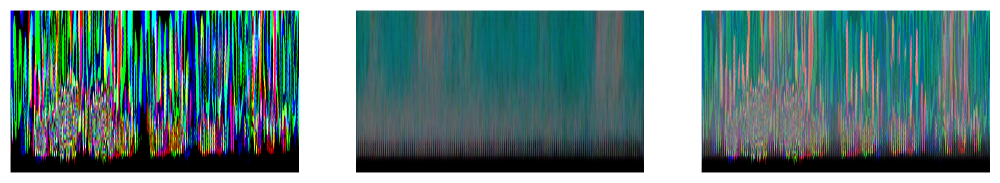

2 5571100
Epoch 1/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 27s 82ms/step - loss: 0.1953 - val_loss: 0.1949
Epoch 2/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 74ms/step - loss: 0.1951 - val_loss: 0.1952
Epoch 3/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 76ms/step - loss: 0.1948 - val_loss: 0.1953
Epoch 4/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 74ms/step - loss: 0.1947 - val_loss: 0.1957
Epoch 5/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 75ms/step - loss: 0.1947 - val_loss: 0.1962
Epoch 6/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 75ms/step - loss: 0.1950 - val_loss: 0.1960
Epoch 7/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 74ms/step - loss: 0.1947 - val_loss: 0.1959
Epoch 8/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 74ms/step - loss: 0.1943 - val_loss: 0.1959
Epoch 9/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 25s 76ms/step - loss: 0.1944 - val_loss: 0.1960
Epoch 10/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 74ms/step - loss: 0.1944 - val_loss: 0.1962
Epoch 11/20
323/323 ━━━━━━━━━━━━━━━━━━━━ 24s 75ms/step - loss: 0.1940 - val_loss: 0.1963
Epoch 12/20
323/323 

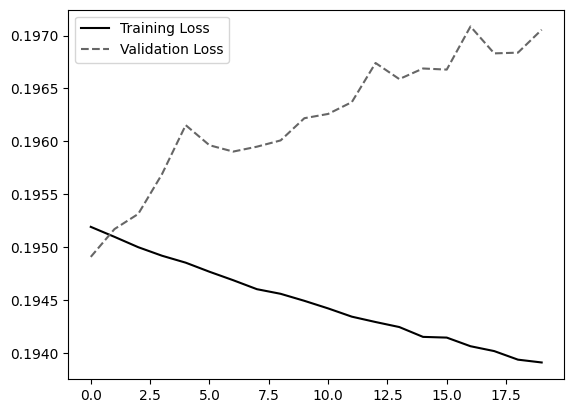

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


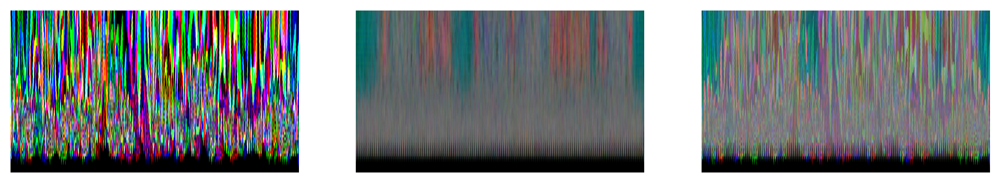

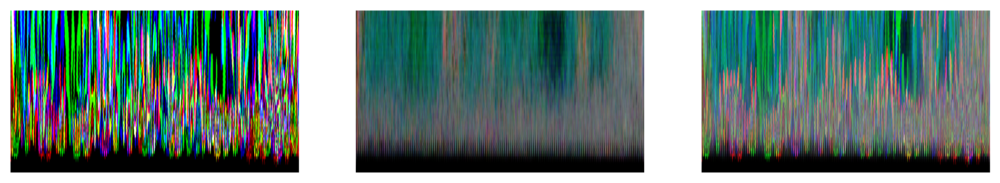

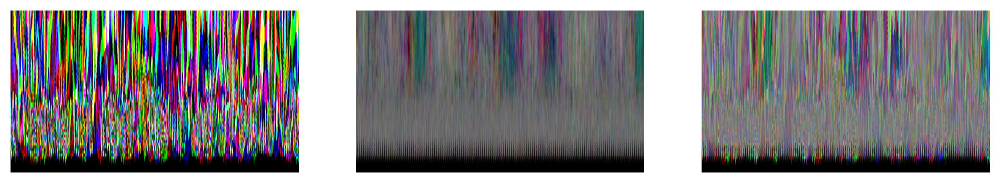

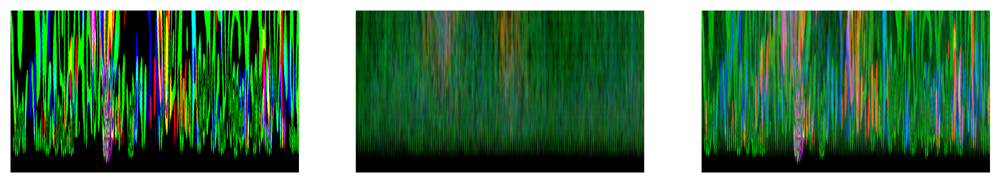

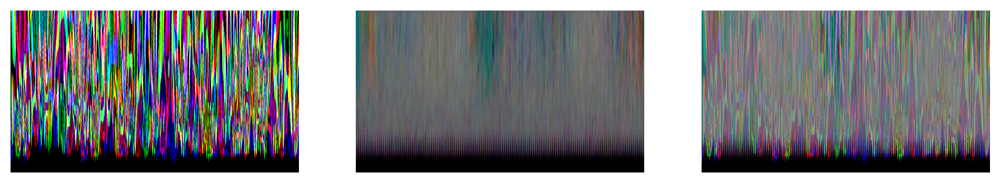

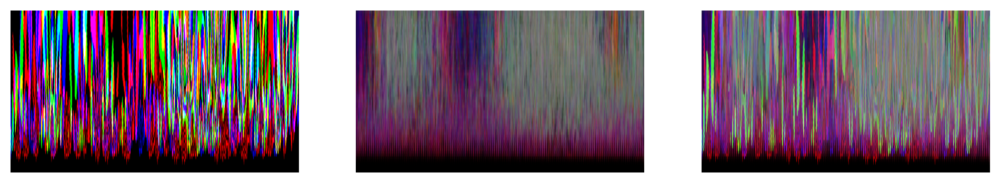

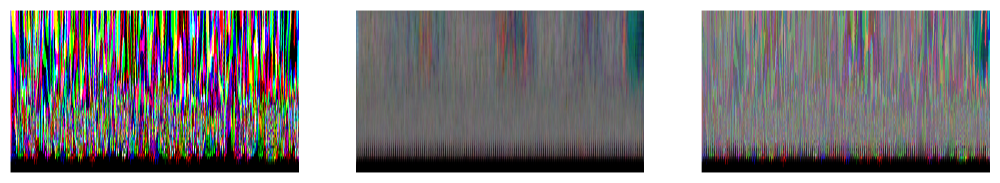

3 5801200
Epoch 1/20
271/271 ━━━━━━━━━━━━━━━━━━━━ 33s 121ms/step - loss: 0.1965 - val_loss: 0.1972
Epoch 2/20
271/271 ━━━━━━━━━━━━━━━━━━━━ 20s 73ms/step - loss: 0.1961 - val_loss: 0.1974
Epoch 3/20
271/271 ━━━━━━━━━━━━━━━━━━━━ 20s 74ms/step - loss: 0.1959 - val_loss: 0.1978
Epoch 4/20
271/271 ━━━━━━━━━━━━━━━━━━━━ 20s 74ms/step - loss: 0.1957 - val_loss: 0.1982
Epoch 5/20
271/271 ━━━━━━━━━━━━━━━━━━━━ 20s 75ms/step - loss: 0.1956 - val_loss: 0.1980


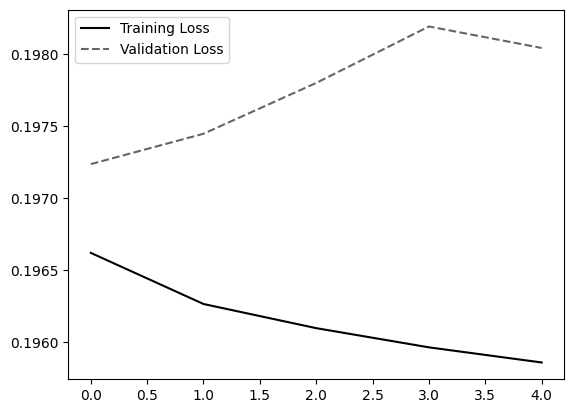

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


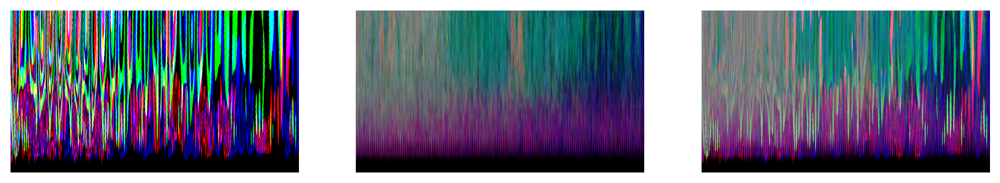

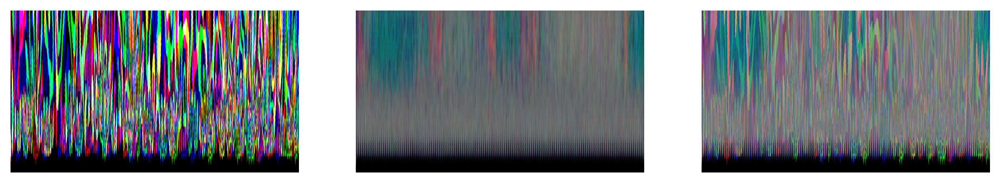

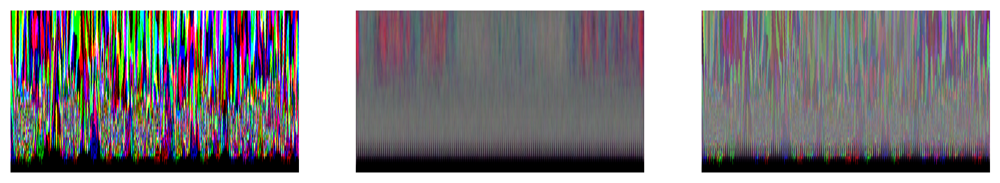

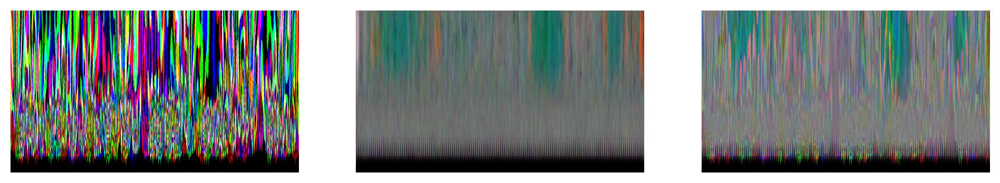

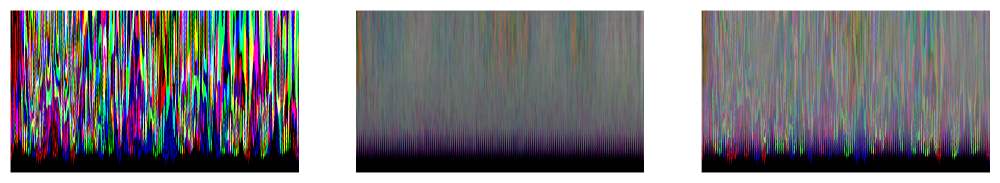

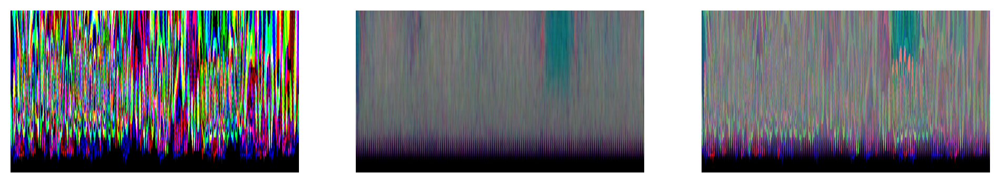

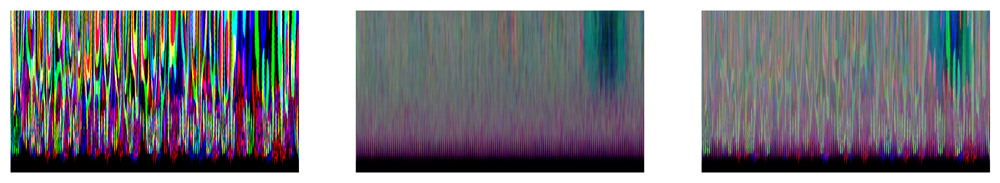

4 5948300
Epoch 1/20
272/272 ━━━━━━━━━━━━━━━━━━━━ 31s 113ms/step - loss: 0.1959 - val_loss: 0.1970
Epoch 2/20
272/272 ━━━━━━━━━━━━━━━━━━━━ 20s 73ms/step - loss: 0.1957 - val_loss: 0.1973
Epoch 3/20
272/272 ━━━━━━━━━━━━━━━━━━━━ 20s 74ms/step - loss: 0.1956 - val_loss: 0.1975
Epoch 4/20
272/272 ━━━━━━━━━━━━━━━━━━━━ 20s 73ms/step - loss: 0.1956 - val_loss: 0.1978
Epoch 5/20
272/272 ━━━━━━━━━━━━━━━━━━━━ 20s 73ms/step - loss: 0.1955 - val_loss: 0.1980


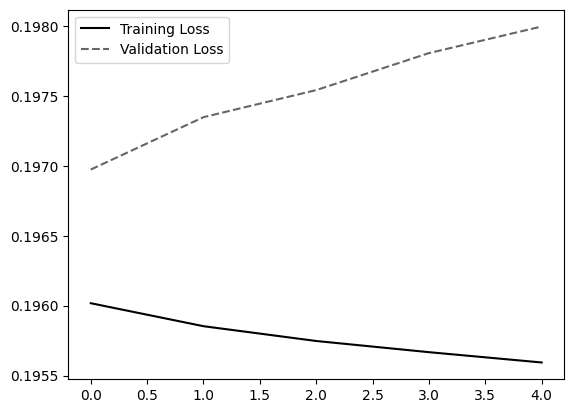

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


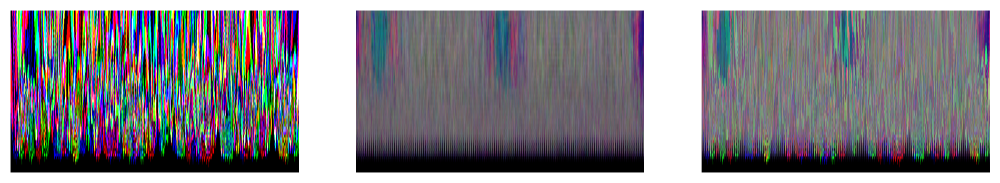

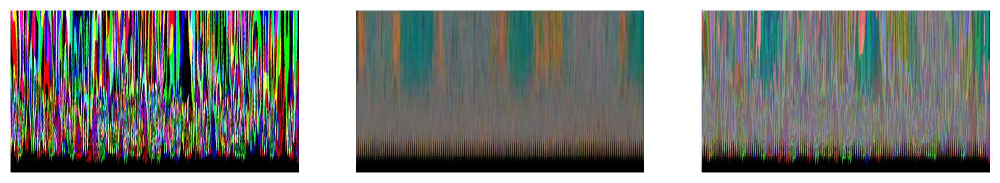

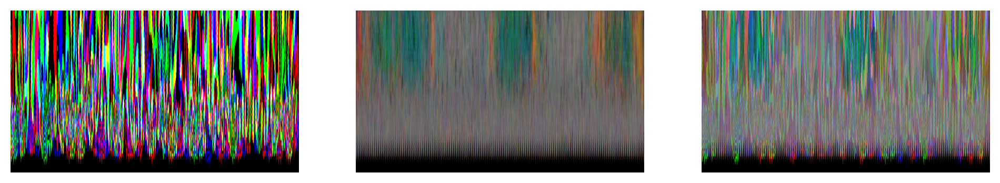

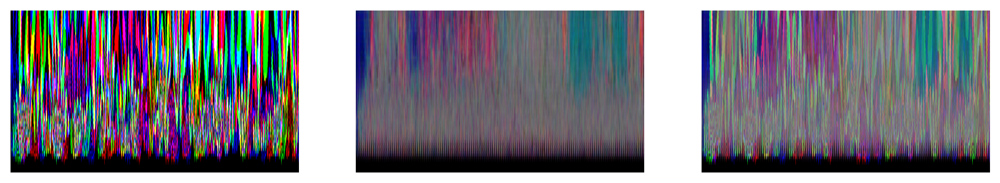

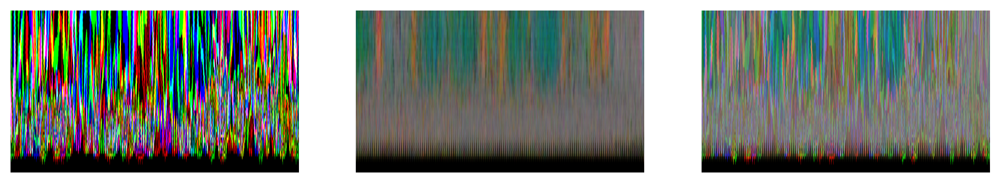

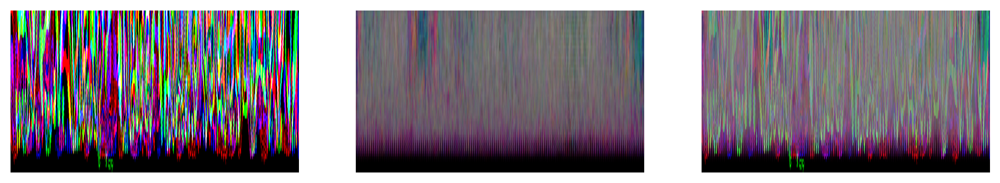

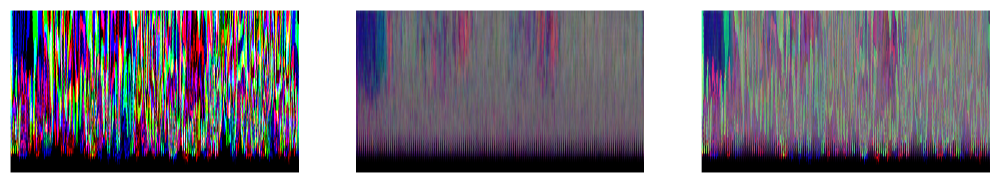

5 6081600


/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Epoch 1/20
327/327 ━━━━━━━━━━━━━━━━━━━━ 32s 97ms/step - loss: 0.1982 - val_loss: 0.1980
Epoch 2/20
327/327 ━━━━━━━━━━━━━━━━━━━━ 24s 74ms/step - loss: 0.1977 - val_loss: 0.1982
Epoch 3/20
327/327 ━━━━━━━━━━━━━━━━━━━━ 25s 75ms/step - loss: 0.1977 - val_loss: 0.1985
Epoch 4/20
327/327 ━━━━━━━━━━━━━━━━━━━━ 24s 73ms/step - loss: 0.1977 - val_loss: 0.1986
Epoch 5/20
327/327 ━━━━━━━━━━━━━━━━━━━━ 24s 74ms/step - loss: 0.1977 - val_loss: 0.1988


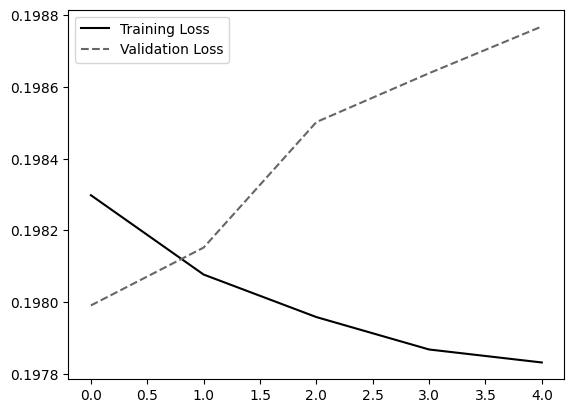

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


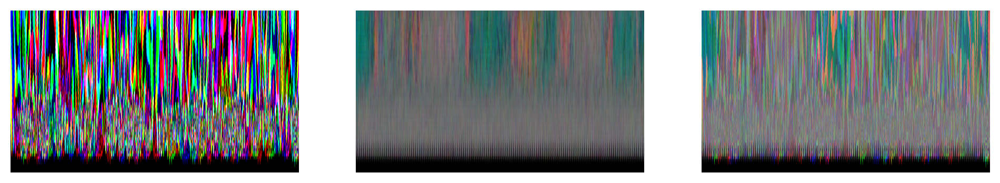

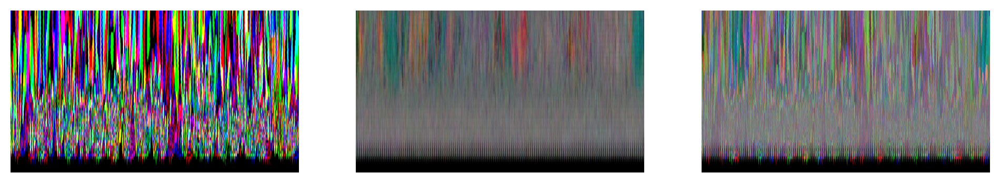

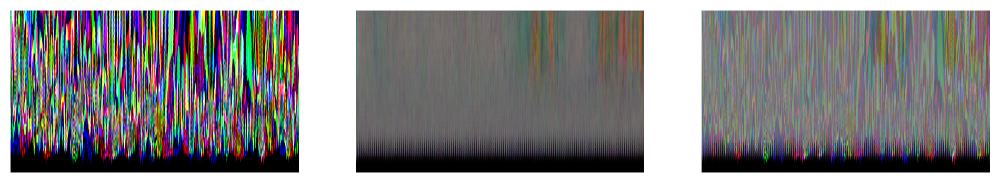

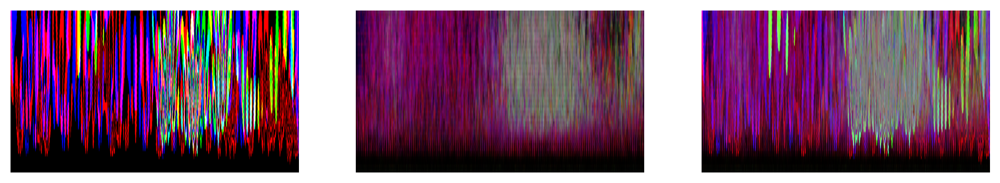

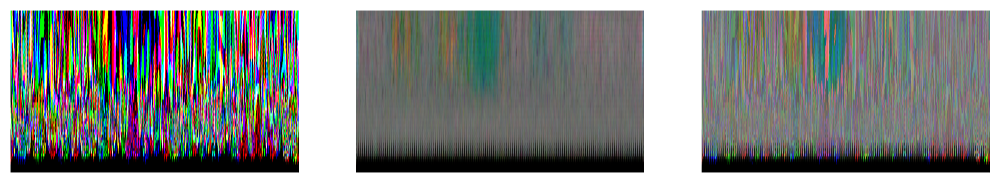

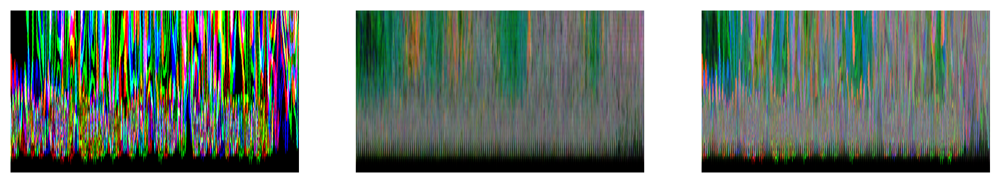

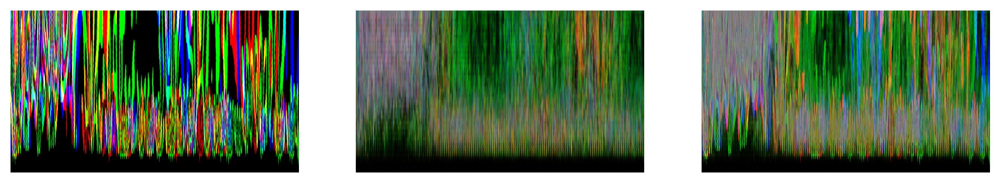

6 6247400


In [ ]:

if RunTwice:
    for j in range(int(len(files)/FilesPerRun)-2):
        j+=2
        Mats=[]
        AllDatas = Parallel(n_jobs=ConcurrentFiles)(delayed(runWrapper)(files[(i+j)*7], False, False, 0, ti()) for i in range(FilesPerRun))
        for fileResponse in AllDatas:
            for Mat in fileResponse:
                Mats.append(Mat)
        
        if MemoryProtection:
            del AllDatas
        
        lengths = []
        rejects = []
        Keeps = []
        
        for Mat in Mats:
            spm = np.shape(Mat)
            if len(spm) > 1:
                lenM = spm[1]
            else:
                lenM = 1
            if (lenM > 1250):
                lengths.append(lenM)
                Keeps.append(Mat)
            else:
                rejects.append(lenM)
        
        if MemoryProtection:
            del Mats
        
        Prints = []
        
        
        AllPrints = Parallel(n_jobs=8)(delayed(PrintWrap)(Mat) for Mat in Keeps)
        
        if MemoryProtection:
            del Keeps
        
        for group in AllPrints:
            for fprint in group:
                Prints.append(fprint)
        
        if MemoryProtection:
            del AllPrints
        
        
        random.shuffle(Prints)
        
        TestLength = int(len(Prints)/TestSplit)
        
        for i, image in enumerate(Prints):
            if not isinstance(image, np.ndarray):
                Prints[i] = np.array(image, dtype=np.float32)
            elif image.dtype != np.float32:
                Prints[i] = image.astype(np.float32)
        
        # Stack the images into a single NumPy array
        prints_array = np.stack(Prints, axis=0)
        
        if MemoryProtection:
            del Prints
        
        # Convert the NumPy array to a TensorFlow tensor
        trX = tf.convert_to_tensor(prints_array)
        
        if MemoryProtection:
            del prints_array
        
        ImageShape = np.shape(trX)
        
        #trX = tensor_prints[:TestLength]  #tf.convert_to_tensor(trainX, dtype=tf.float32)
        
        #teX = tensor_prints[TestLength:]  #tf.convert_to_tensor(testX, dtype=tf.float32)
        
        #if MemoryProtection:
        #    del tensor_prints
        
        checkpoint_callback = CustomModelCheckpoint(
            filepath='/scratch/models/3DFP_0928_'+str(j)+'_{epoch:02d}.keras',
            save_freq=3  
        )
        
        H = autoencoder.fit(
        	trX, trX,
        	validation_split=0.1,
        	epochs=20,
            callbacks=[checkpoint_callback, es_callback],     
        	batch_size=BS*2)
        
        plt.plot(H.history["loss"], label="Training Loss")
        plt.plot(H.history["val_loss"], label="Validation Loss")
        plt.legend()
        plt.show()

        #random.shuffle(trX)
        
        x_train_pred = autoencoder.predict(trX[:7])
        
        for i in range(7):
            fig, (ax1, ax2, ax3) = plt.subplots(1, 3,figsize=(12,2), dpi=200 )
            ax1.imshow(trX[i], origin='lower',aspect='auto')
            ax1.axis("off")
            ax2.imshow(x_train_pred[i], origin='lower',aspect='auto')
            ax2.axis("off")
            ax3.imshow(np.abs(trX[i]-x_train_pred[i]), origin='lower',aspect='auto')
            ax3.axis("off")
            plt.show()

        del trX, x_train_pred
    
        print(j, int((ti()-toc)/.6)/100)